In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import random
import os

import warnings
warnings.filterwarnings('ignore')

import koreanize_matplotlib

from sklearn.cluster import KMeans

In [2]:
def seed_everything(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)

seed_everything(42)

In [3]:
train = pd.read_csv('./데이터/train.csv', encoding='cp949')
test = pd.read_csv('./데이터/test.csv', encoding='cp949')
sub = pd.read_csv('./데이터/sample_submission.csv', encoding='cp949')

In [4]:
train.head()

,num,date_time,전력사용량(kWh),기온(°C),풍속(m/s),습도(%),강수량(mm),일조(hr),비전기냉방설비운영,태양광보유
0,1,2020-06-01 00,8179.056,17.6,2.5,92.0,0.8,0.0,0.0,0.0
1,1,2020-06-01 01,8135.640,17.7,2.9,91.0,0.3,0.0,0.0,0.0
2,1,2020-06-01 02,8107.128,17.5,3.2,91.0,0.0,0.0,0.0,0.0
3,1,2020-06-01 03,8048.808,17.1,3.2,91.0,0.0,0.0,0.0,0.0
4,1,2020-06-01 04,8043.624,17.0,3.3,92.0,0.0,0.0,0.0,0.0


In [5]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 122400 entries, 0 to 122399
Data columns (total 10 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   num         122400 non-null  int64  
 1   date_time   122400 non-null  object 
 2   전력사용량(kWh)  122400 non-null  float64
 3   기온(°C)      122400 non-null  float64
 4   풍속(m/s)     122400 non-null  float64
 5   습도(%)       122400 non-null  float64
 6   강수량(mm)     122400 non-null  float64
 7   일조(hr)      122400 non-null  float64
 8   비전기냉방설비운영   122400 non-null  float64
 9   태양광보유       122400 non-null  float64
dtypes: float64(8), int64(1), object(1)
memory usage: 9.3+ MB


In [6]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10080 entries, 0 to 10079
Data columns (total 9 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   num           10080 non-null  int64  
 1   date_time     10080 non-null  object 
 2   기온(°C)        3360 non-null   float64
 3   풍속(m/s)       3360 non-null   float64
 4   습도(%)         3360 non-null   float64
 5   강수량(mm, 6시간)  1680 non-null   float64
 6   일조(hr, 3시간)   3360 non-null   float64
 7   비전기냉방설비운영     2296 non-null   float64
 8   태양광보유         1624 non-null   float64
dtypes: float64(7), int64(1), object(1)
memory usage: 708.9+ KB


In [7]:
test.head(10)

,num,date_time,기온(°C),풍속(m/s),습도(%),"강수량(mm, 6시간)","일조(hr, 3시간)",비전기냉방설비운영,태양광보유
0,1,2020-08-25 00,27.8,1.5,74.0,0.0,0.0,NaN,NaN
1,1,2020-08-25 01,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,2020-08-25 02,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,2020-08-25 03,27.3,1.1,78.0,NaN,0.0,NaN,NaN
4,1,2020-08-25 04,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,1,2020-08-25 05,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,1,2020-08-25 06,26.1,1.3,83.0,0.0,0.0,NaN,NaN
7,1,2020-08-25 07,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,1,2020-08-25 08,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,1,2020-08-25 09,28.8,1.2,77.0,NaN,1.1,NaN,NaN


# feature 이름 변경

In [8]:
train.columns = ['건물번호', '시간', '전력사용량', '기온','풍속', '습도', '강수량', '일조', '비전기냉방설비운영', '태양광보유']

In [9]:
test.columns = ['건물번호', '시간', '기온', '풍속', '습도', '강수량', '일조', '비전기냉방설비운영', '태양광보유']

In [10]:
building_info = train[['건물번호','비전기냉방설비운영', '태양광보유']].drop_duplicates()

test.drop(['비전기냉방설비운영', '태양광보유'], axis=1, inplace = True)
test = pd.merge(test, building_info, on= '건물번호')

# 시간

In [11]:
train['시간'] = pd.to_datetime(train['시간'])
test['시간'] = pd.to_datetime(test['시간'])

In [12]:
def datetime_chage(df):
    df['hour'] = df['시간'].dt.hour
    df['weekday'] = df['시간'].dt.weekday
    # 5, 6 주말
    df['date'] = df['시간'].dt.date
    df['date'] = pd.to_datetime(train['date'])
    df['day'] = df['시간'].dt.day
    df['month'] = df['시간'].dt.month

datetime_chage(train)
datetime_chage(test)

In [13]:
train

,건물번호,시간,전력사용량,기온,풍속,습도,강수량,일조,비전기냉방설비운영,태양광보유,hour,weekday,date,day,month
0,1,2020-06-01 00:00:00,8179.056,17.6,2.5,92.0,0.8,0.0,0.0,0.0,0,0,2020-06-01,1,6
1,1,2020-06-01 01:00:00,8135.640,17.7,2.9,91.0,0.3,0.0,0.0,0.0,1,0,2020-06-01,1,6
2,1,2020-06-01 02:00:00,8107.128,17.5,3.2,91.0,0.0,0.0,0.0,0.0,2,0,2020-06-01,1,6
3,1,2020-06-01 03:00:00,8048.808,17.1,3.2,91.0,0.0,0.0,0.0,0.0,3,0,2020-06-01,1,6
4,1,2020-06-01 04:00:00,8043.624,17.0,3.3,92.0,0.0,0.0,0.0,0.0,4,0,2020-06-01,1,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
122395,60,2020-08-24 19:00:00,4114.368,27.8,2.3,68.0,0.0,0.7,1.0,1.0,19,0,2020-08-24,24,8
122396,60,2020-08-24 20:00:00,3975.696,27.3,1.2,71.0,0.0,0.0,1.0,1.0,20,0,2020-08-24,24,8
122397,60,2020-08-24 21:00:00,3572.208,27.3,1.8,71.0,0.0,0.0,1.0,1.0,21,0,2020-08-24,24,8
122398,60,2020-08-24 22:00:00,3299.184,27.1,1.8,74.0,0.0,0.0,1.0,1.0,22,0,2020-08-24,24,8


In [14]:
train['weekday'].unique()

array([0, 1, 2, 3, 4, 5, 6])

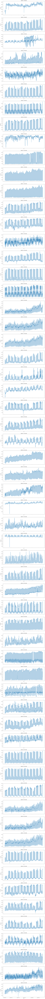

In [15]:
# 고유한 건물번호 추출
building_numbers = train['건물번호'].unique()

# 건물번호별로 그래프 그리기
fig, axes = plt.subplots(len(building_numbers), 1, figsize=(15, 6*len(building_numbers)), sharex=True)

for i, building_number in enumerate(building_numbers):
    building_data = train[train['건물번호'] == building_number]
    axes[i].plot(building_data['시간'], building_data['전력사용량'])
    axes[i].set_xlabel('시간')
    axes[i].set_ylabel('전력사용량')
    axes[i].set_title(f'건물번호 {building_number} 전력사용량')

# 9번 건물 이상치 처리

In [16]:
train[(train['건물번호']==9) & (train['전력사용량']<1000)];
train.loc[16374,'전력사용량'] = (1200 + 1251.180) / 2
train.loc[16375,'전력사용량'] = (1200 + 1255.176) / 2
train.loc[16376,'전력사용량'] = (1200 + 1249.668) / 2
train.loc[16377,'전력사용량'] = (1200 + 1234.332) / 2
train.loc[16378,'전력사용량'] = (1200 + 1199.556) / 2
train.loc[16379,'전력사용량'] = (1200 + 1204.524) / 2
train.loc[16380,'전력사용량'] = (1200 + 1196.748) / 2
train.loc[16381,'전력사용량'] = (1200 + 1186.704) / 2
train.loc[16382,'전력사용량'] = (1200 + 1187.028) / 2
train.loc[16383,'전력사용량'] = (1200 + 1197.396) / 2
train.loc[16402,'전력사용량'] = (1200 + 1256.472) / 2
train.loc[17407,'전력사용량'] = (1302.156 + 1285.848) / 2
train.loc[17408,'전력사용량'] = (1289.844 + 1287.144) / 2
train.loc[17409,'전력사용량'] = (1264.356 + 1294.056) / 2
train.loc[17410,'전력사용량'] = (1250.316 + 1304.424) / 2
train.loc[17411,'전력사용량'] = (1255.392 + 1293.732) / 2
train.loc[17412,'전력사용량'] = (1248.804 + 1291.032) / 2
train.loc[17413,'전력사용량'] = (1253.664 + 1299.564) / 2
train.loc[17414,'전력사용량'] = (1257.552 + 1302.588) / 2
train.loc[17415,'전력사용량'] = (1270.944 + 1305.504) / 2
train.loc[17416,'전력사용량'] = (1326.024 + 1310.580) / 2
train.loc[17530,'전력사용량'] = (1285.416 + 1314.468) / 2
train.loc[17531,'전력사용량'] = (1279.692000 + 1317.708000) / 2
train.loc[17532,'전력사용량'] = (1276.884000 + 1278.828000) / 2
train.loc[17533,'전력사용량'] = (1287.252000 + 1280.124000) / 2

# 25번 건물 이상치 처리

In [17]:
train[(train['건물번호']==25) & (train['전력사용량']<500)];
train.loc[49954,'전력사용량'] = (1270.080 + 1041.984) / 2
train.loc[49955,'전력사용량'] = (1257.768 + 1039.392) / 2

# 27번 건물 이상치 처리

In [18]:
train[(train['건물번호']==27) & (train['전력사용량']<100)];
train.loc[54684,'전력사용량'] = (241.38 + 439.02) / 2
train.loc[54685,'전력사용량'] = (541.35 + 460.35) / 2
train.loc[54686,'전력사용량'] = (564.03 + 582.93) / 2
train.loc[54687,'전력사용량'] = (588.06 + 561.06) / 2
train.loc[54688,'전력사용량'] = (615.06 + 540.27) / 2
train.loc[55044,'전력사용량'] = (368.01 + 235.44) / 2

# 31, 33, 36번 건물 이상치 처리

In [19]:
def power_mean(index1, index2, target) :
    val1 = train.loc[index1, '전력사용량']
    val2 = train.loc[index2, '전력사용량']
    power_avg = round(np.mean([val1, val2]), 3)
    train.loc[target, '전력사용량'] = power_avg

# 31번 건물
power_mean(61289, 61625, 61457)

# 33번 건물
power_mean(65369, 65705, 65537)

# 36번 건물
# 6월 19일 6시
power_mean(71670, 72006, 71838)

# 8월 12일 5~8시
power_mean(72965, 73301, 73133)
power_mean(72966, 73302, 73134)
power_mean(72967, 73303, 73135)
power_mean(72967, 73304, 73136)

# 45, 55, 60번 건물 이상치 처리

In [20]:
# 45번 건물
train.loc[90577,'전력사용량'] = (train.loc[90409,'전력사용량'] + train.loc[90745,'전력사용량']) / 2

# 55번 건물
train.loc[111802,'전력사용량'] = (train.loc[111634,'전력사용량'] + train.loc[111970,'전력사용량']) / 2
train.loc[111803,'전력사용량'] = (train.loc[111635,'전력사용량'] + train.loc[111971,'전력사용량']) / 2
train.loc[111808,'전력사용량'] = (train.loc[111640,'전력사용량'] + train.loc[111976,'전력사용량']) / 2
train.loc[111809,'전력사용량'] = (train.loc[111641,'전력사용량'] + train.loc[111977,'전력사용량']) / 2

# 60번 건물
train.loc[121081,'전력사용량'] = (train.loc[120913,'전력사용량'] + train.loc[121249,'전력사용량']) / 2

# 이상치 변경 확인

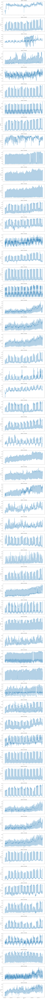

In [21]:
# 고유한 건물번호 추출
building_numbers = train['건물번호'].unique()

# 건물번호별로 그래프 그리기
fig, axes = plt.subplots(len(building_numbers), 1, figsize=(15, 6*len(building_numbers)), sharex=True)

for i, building_number in enumerate(building_numbers):
    building_data = train[train['건물번호'] == building_number]
    axes[i].plot(building_data['시간'], building_data['전력사용량'])
    axes[i].set_xlabel('시간')
    axes[i].set_ylabel('전력사용량')
    axes[i].set_title(f'건물번호 {building_number} 전력사용량')

# test 결측치 처리

In [22]:
train_ = train.copy()
def make_train_nan(col, n):
    new_list = []
    for idx, temp in enumerate(train_[col]):
        if idx%n==0:
            new_list.append(temp)
        else:
            new_list.append(np.nan)
    train_['{}'.format(col+'_nan')] = new_list


make_train_nan('기온',3)
make_train_nan('풍속',3)
make_train_nan('습도',3)
make_train_nan('강수량',6)

print(train_.iloc[:,-4:].isnull().sum())

기온_nan      81600
풍속_nan      81600
습도_nan      81600
강수량_nan    102000
dtype: int64


In [23]:
def compare_interpolate_methods(col, methods, metric):
    error_dict = dict()
    for method in methods:
        fillna = train_['{}'.format(col+'_nan')].interpolate(method=method)
        if fillna.isna().sum() != 0:
            fillna = fillna.interpolate(method='linear')
        error = metric(train_['{}'.format(col)], fillna)
        error_dict['{}'.format(method)] = error
    
    return error_dict

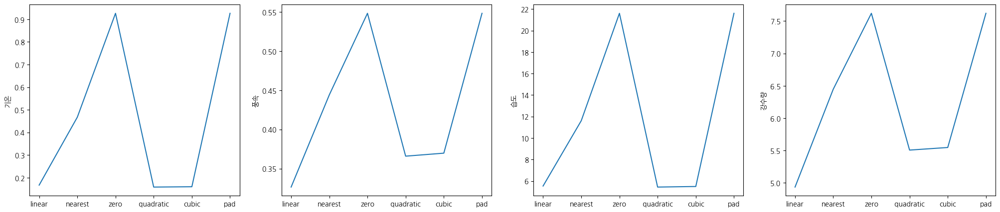

In [24]:
from sklearn.metrics import mean_squared_error
all_cols_error_dict = dict()
for col in ['기온', '풍속', '습도', '강수량']:
    methods = ['linear', 'nearest', 'zero', 'quadratic', 'cubic', 'pad']
    error_dict = compare_interpolate_methods(col, methods, mean_squared_error)
    all_cols_error_dict['{}'.format(col)] = error_dict
    
all_cols_error_df = pd.DataFrame(all_cols_error_dict)

fig, axes = plt.subplots(1,4, figsize = (25,5), sharey=False)
for i in range(len(all_cols_error_df.columns)):
    sns.lineplot(ax=axes[i], data=all_cols_error_df.iloc[:,i].transpose())

In [25]:
#기온 결측치 채우기
test['기온'] = test['기온'].interpolate(method='quadratic')
#마지막 na 채우기
test['기온'] = test['기온'].interpolate(method='linear')

#풍속 결측치 채우기
test['풍속'] = test['풍속'].interpolate(method='linear')

#습도 결측치 채우기
test['습도'] = test['습도'].interpolate(method='quadratic')
#마지막 na 채우기
test['습도'] = test['습도'].interpolate(method='linear')

#강수량 결측치 채우기
test['강수량'] = test['강수량'].interpolate(method='linear')

test['일조'] = test['일조'].interpolate(method='pad')

In [26]:
def scale_column(column):
    min_val = column.min()
    max_val = column.max()
    scaled_column = (column - min_val) / (max_val - min_val)
    return scaled_column

test['일조'] = scale_column(test['일조'])

# 시계열 분석
- 건물별로 시계열 분포가 다르므로 대표로 2개의 건물(건물4, 건물9)에 대해 시계열 분석을 하여 어떤 시계열적 특징이 있는지 확인

## 시계열 분해
- 우선 시계열 분해를 통해 건물별 전력사용량을 추세, 계절성, 잔차로 분해

In [27]:
#Time Series Analysis
import statsmodels.api as sm
from statsmodels.tsa.stattools import adfuller, kpss, ccf
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

In [28]:
def vis_time_series_decompose(num):
    df = train[train.건물번호==num]
    df.index = df.시간

    res = sm.tsa.seasonal_decompose(df['전력사용량'], model='additive')

    fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(20, 12))
    res.observed.plot(ax=ax1, title='Observed')
    res.trend.plot(ax=ax2, title='Trend')
    res.resid.plot(ax=ax3, title='Residual')
    res.seasonal.plot(ax=ax4, title='Seasonal')
    plt.tight_layout()
    plt.show()

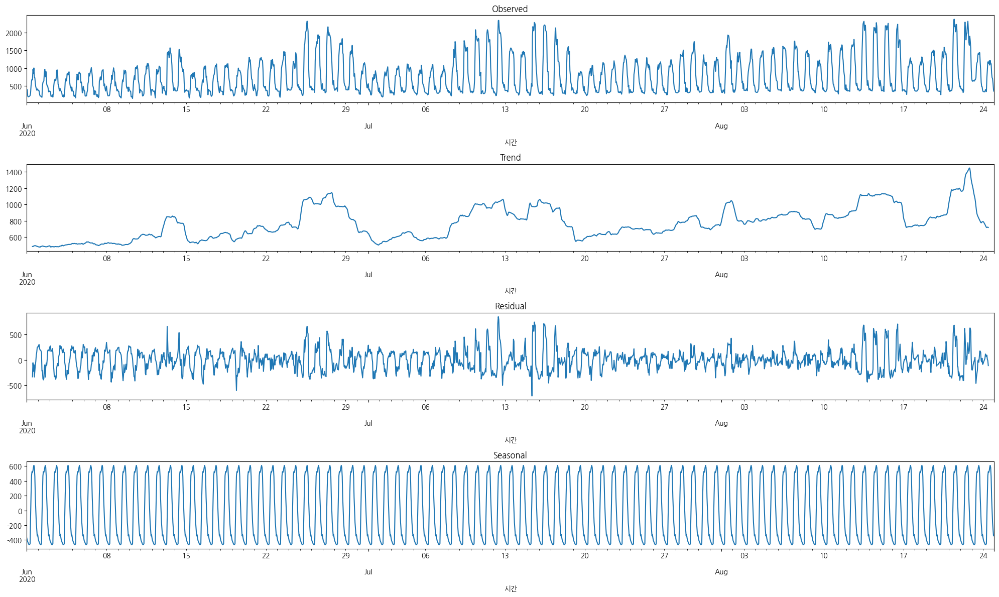

In [29]:
## 건물4
vis_time_series_decompose(num=4)

# 건물4의 경우, 하루를 주기로 계절성을 지님을 알 수 있습니다. 또한 85일동안 특별히 증가하거나 감소하는 추세는 보이지 않습니다.

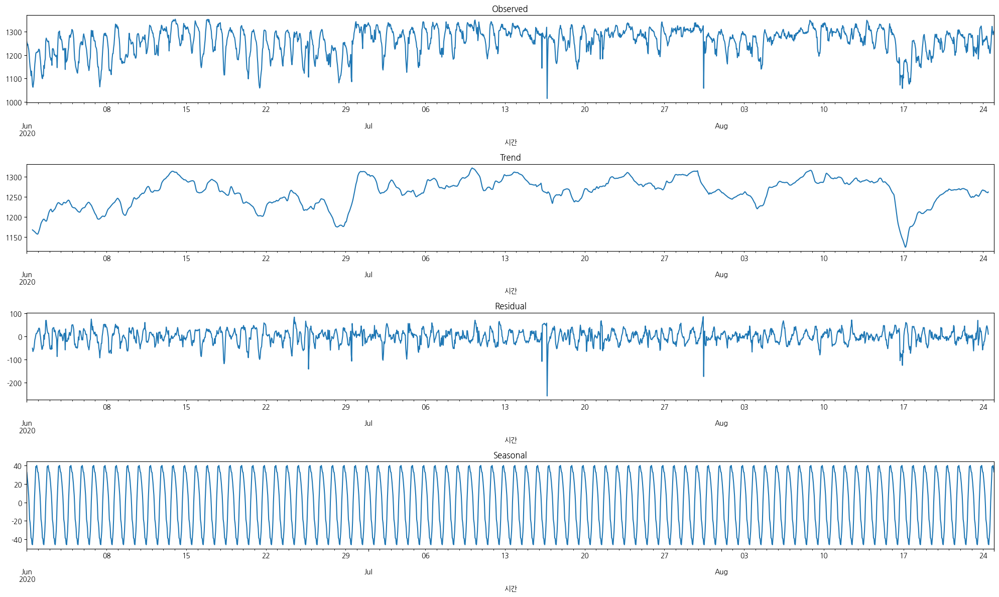

In [30]:
## 건물9
vis_time_series_decompose(num=9)

# 건물9의 경우, 마찬가지로 하루를 주기로 계절성을 지님을 알 수 있습니다. 또한 85일동안 특별히 증가하거나 감소하는 추세는 보이지 않습니다.

#  하루 단위의 계절성이 존재함으로 하루 단위로 시간에 따른 전력사용량을 관찰할 필요가 있음을 알 수 있습니다.
# 따라서 아래에 건물별로 시간별 평균 전력사용량에 대한 분석을 진행

## 자기상관, 부분자기상관
- PACF를 봤을 때 두 건물 모두 전력사용량은 1시간, 2시간 전과 크게 관계가 있고, 약 24시간 전의 전력사용량에도 약간의 영향을 받음을 확인할 수 있습니다. 따라서 이후 시계열 예측을 진행할 때 직전 시간뿐만 아니라, 24시간 전의 데이터도 활용하여 학습

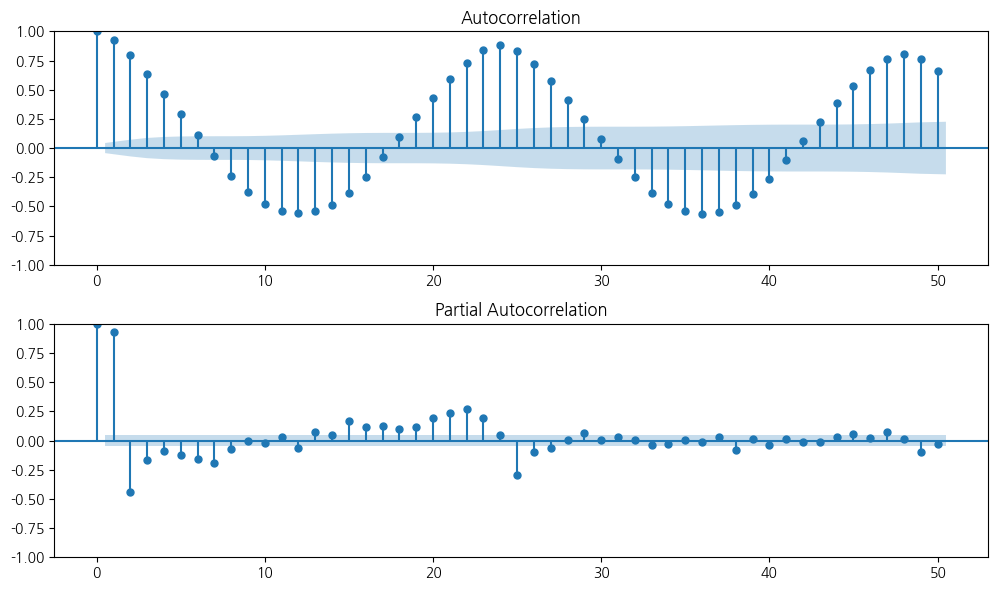

In [31]:
## 건물4
df = train[train.건물번호==4]
fig, (ax1, ax2) = plt.subplots(nrows=2, figsize=(10, 6))
plot_acf(df['전력사용량'], lags=50, ax=ax1)
plot_pacf(df['전력사용량'], lags=50, ax=ax2)
plt.tight_layout()
plt.show()

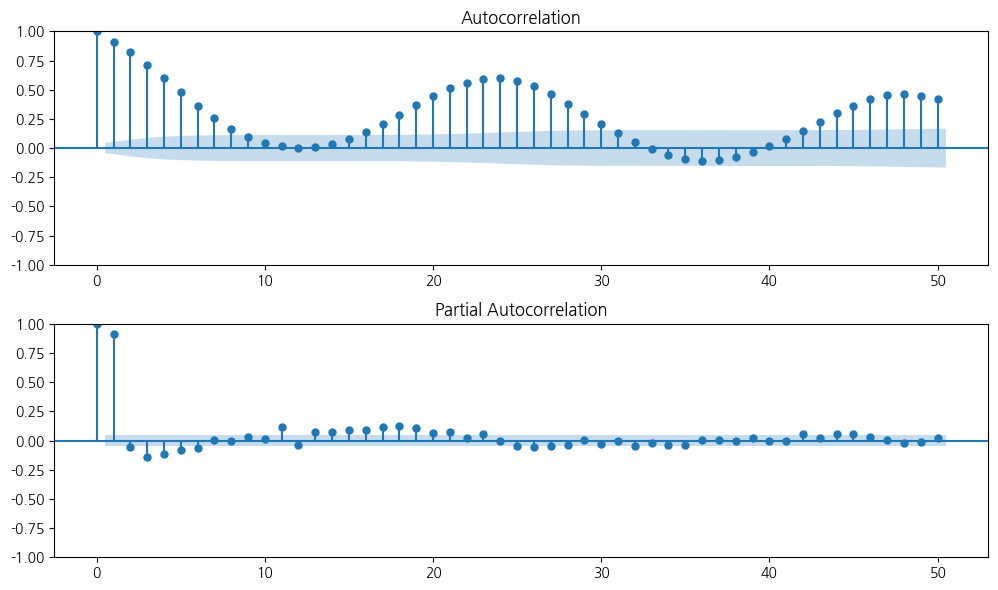

In [32]:
## 건물9
df = train[train.건물번호==9]
fig, (ax1, ax2) = plt.subplots(nrows=2, figsize=(10, 6))
plot_acf(df['전력사용량'], lags=50, ax=ax1)
plot_pacf(df['전력사용량'], lags=50, ax=ax2)
plt.tight_layout()
plt.show()

# 군집

## 1. 건물 군집

In [33]:
# 건물을 기준으로 하는 data frame 생성
by_weekday = train.groupby(['건물번호','weekday'])['전력사용량'].median().reset_index().pivot('건물번호','weekday','전력사용량').reset_index()
by_hour = train.groupby(['건물번호','hour'])['전력사용량'].median().reset_index().pivot('건물번호','hour','전력사용량').reset_index().drop('건물번호', axis = 1)
df = pd.concat([by_weekday, by_hour], axis= 1)
columns = ['건물번호'] + ['day'+str(i) for i in range(7)] + ['hour'+str(i) for i in range(24)]
df.columns = columns

In [34]:
# '전력사용량'이 아닌 '요일과 시간대에 따른 전력 사용량의 경향성'에 따라서만 군집화 할 것이므로, 특수한 scaling이 필요함
# standard scaling
for i in range(len(df)):
    # 요일 별 전력 중앙값에 대해 scaling
    df.iloc[i,1:8] = (df.iloc[i,1:8] - df.iloc[i,1:8].mean())/df.iloc[i,1:8].std()
    # 시간대별 전력 중앙값에 대해 scaling
    df.iloc[i,8:] = (df.iloc[i,8:] - df.iloc[i,8:].mean())/df.iloc[i,8:].std()

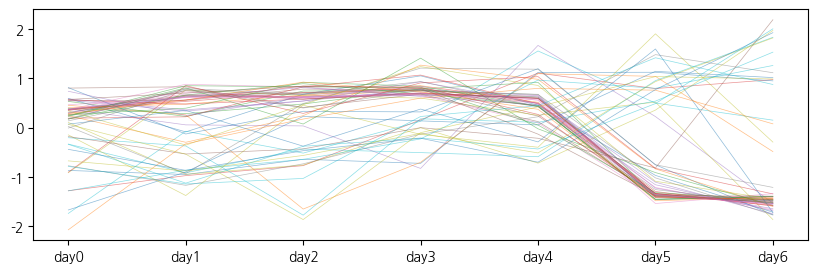

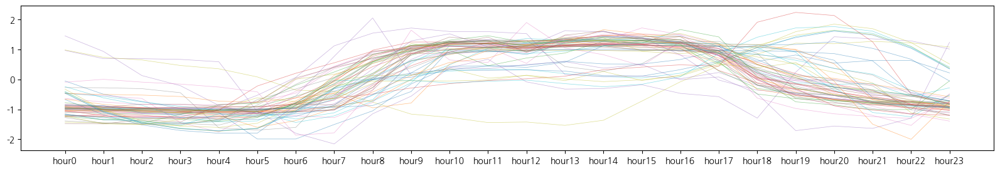

In [35]:
# visualization
fig = plt.figure(figsize = (10,3))
for i in range(len(df)):
    plt.plot(df.iloc[i, 1:8], alpha = 0.5, linewidth = 0.5)
fig = plt.figure(figsize = (20,3))
for i in range(len(df)):
    plt.plot(df.iloc[i, 8:], alpha = 0.5, linewidth = 0.5)

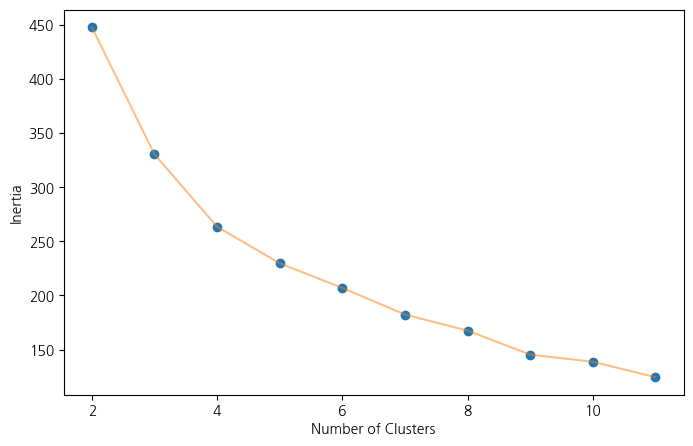

In [36]:
# elbow method를 통해 군집의 개수 결정
def change_n_clusters(n_clusters, data):
    sum_of_squared_distance = []
    for n_cluster in n_clusters:
        kmeans = KMeans(n_clusters=n_cluster)
        kmeans.fit(data)
        sum_of_squared_distance.append(kmeans.inertia_)
        
    plt.figure(1 , figsize = (8, 5))
    plt.plot(n_clusters , sum_of_squared_distance , 'o')
    plt.plot(n_clusters , sum_of_squared_distance , '-' , alpha = 0.5)
    plt.xlabel('Number of Clusters')
    plt.ylabel('Inertia')

change_n_clusters([2,3,4,5,6,7,8,9,10,11], df.iloc[:,1:])

In [37]:
# 실루엣 점수
from sklearn.metrics import silhouette_score
for k in range(2,10):
    kmeans = KMeans(n_clusters=k, random_state=42, n_init='auto')
    kmeans.fit(df.iloc[:,1:])
    y_pred = kmeans.labels_
    print(k, ": ", silhouette_score(df.iloc[:,1:], y_pred, metric='euclidean'))

# 실루엣 점수로 볼 때 k가 3일 때 가장 점수가 높음 -> 따라서 4(왜냐! 0부터 시작하기 때문)

2 :  0.43361131062157643
3 :  0.4405506191807293
4 :  0.25865992813832145
5 :  0.29054237987144027
6 :  0.2247234114169596
7 :  0.22408500223084638
8 :  0.26252015490359576
9 :  0.19893102006980692


In [38]:
kmeans = KMeans(n_clusters=4, random_state = 2)
km_cluster = kmeans.fit_predict(df.iloc[:,1:])

In [39]:
df_clust = df.copy()
df_clust['건물유형'] = km_cluster

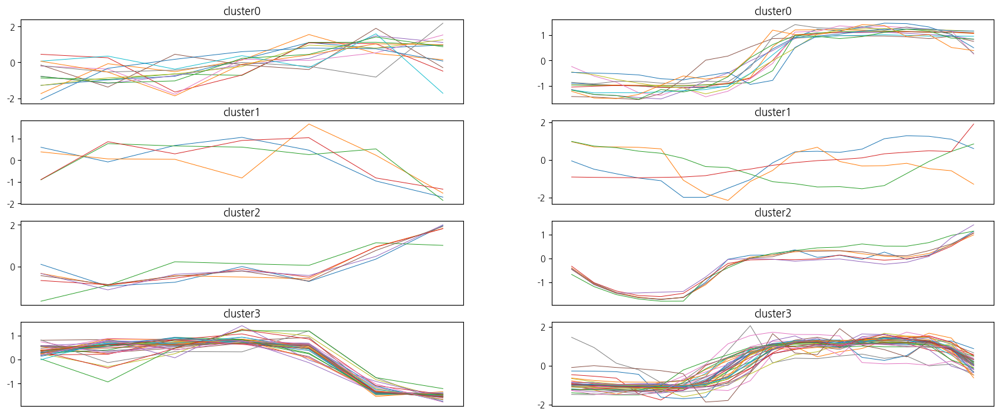

In [40]:
# visualizing result of kmeans clustering
n_c = len(np.unique(df_clust.건물유형)) 

fig = plt.figure(figsize = (20,8))
for c in range(n_c):
    temp = df_clust[df_clust.건물유형 == c]
    plt.subplot(n_c,2,2*c+1)
    for i in range(len(temp)):
        plt.plot(temp.iloc[i,1:8], linewidth=0.7, )
        plt.title(f'cluster{c}')
        plt.xlabel('')
        plt.xticks([])
    plt.subplot(n_c,2,2*c+2)
    for i in range(len(temp)):
        plt.plot(temp.iloc[i,8:-6], linewidth=0.7)
        plt.title(f'cluster{c}')
        plt.xlabel('')
        plt.xticks([])

In [41]:
train = train.merge(df_clust[['건물번호','건물유형']], on = '건물번호', how = 'left')

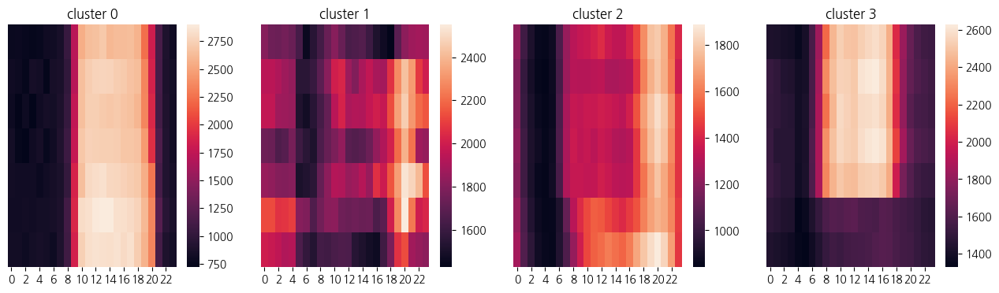

In [42]:
fig = plt.figure(figsize = (20, 4))
for c in range(4):
    temp = train[train.건물유형 == c]
    temp = temp.groupby(['weekday', 'hour'])['전력사용량'].median().reset_index().pivot('weekday', 'hour', '전력사용량')
    plt.subplot(1, 5, c+1)
    sns.heatmap(temp)
    plt.title(f'cluster {c}')
    plt.xlabel('')
    plt.ylabel('')
    plt.yticks([])

In [43]:
df['건물유형'] = kmeans.labels_

In [44]:
test = test.merge(df_clust[['건물번호','건물유형']], on = '건물번호', how = 'left')
test

,건물번호,시간,기온,풍속,습도,강수량,일조,비전기냉방설비운영,태양광보유,hour,weekday,date,day,month,건물유형
0,1,2020-08-25 00:00:00,27.800000,1.500000,74.000000,0.0,0.000000,0.0,0.0,0,1,2020-06-01,25,8,1
1,1,2020-08-25 01:00:00,27.806027,1.366667,75.017358,0.0,0.000000,0.0,0.0,1,1,2020-06-01,25,8,1
2,1,2020-08-25 02:00:00,27.639360,1.233333,76.350691,0.0,0.000000,0.0,0.0,2,1,2020-06-01,25,8,1
3,1,2020-08-25 03:00:00,27.300000,1.100000,78.000000,0.0,0.000000,0.0,0.0,3,1,2020-06-01,25,8,1
4,1,2020-08-25 04:00:00,26.787947,1.166667,79.965285,0.0,0.000000,0.0,0.0,4,1,2020-06-01,25,8,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10075,60,2020-08-31 19:00:00,28.679729,3.566667,65.645299,0.0,0.266667,1.0,1.0,19,0,2020-08-19,31,8,0
10076,60,2020-08-31 20:00:00,28.313063,3.833333,66.645299,0.0,0.266667,1.0,1.0,20,0,2020-08-19,31,8,0
10077,60,2020-08-31 21:00:00,27.900000,4.100000,68.000000,0.0,0.000000,1.0,1.0,21,0,2020-08-19,31,8,0
10078,60,2020-08-31 22:00:00,27.900000,4.100000,68.000000,0.0,0.000000,1.0,1.0,22,0,2020-08-19,31,8,0


## 2. 지역 군집
- 날씨가 같으면 같은 지역이겠다.. 는 생각
- 기온, 습도, 강수량, 일조 모두 같음 -> 그러나, 강수량은 0인 곳이 많아서 의미없다 생각함
- 건물번호별 4개의 평균을 weather_df로 만듦
- PCA로 2개 변수로 차원 축소
- kmeans 진행
- elbow 봤을 때, 3개   /   실루엣 점수로도 3이 적당
- 그래프로 봤을 때 잘 분리가 됨을 확인
- train에 area 지역파생변수 생성

In [45]:
train.head()

,건물번호,시간,전력사용량,기온,풍속,습도,강수량,일조,비전기냉방설비운영,태양광보유,hour,weekday,date,day,month,건물유형
0,1,2020-06-01 00:00:00,8179.056,17.6,2.5,92.0,0.8,0.0,0.0,0.0,0,0,2020-06-01,1,6,1
1,1,2020-06-01 01:00:00,8135.640,17.7,2.9,91.0,0.3,0.0,0.0,0.0,1,0,2020-06-01,1,6,1
2,1,2020-06-01 02:00:00,8107.128,17.5,3.2,91.0,0.0,0.0,0.0,0.0,2,0,2020-06-01,1,6,1
3,1,2020-06-01 03:00:00,8048.808,17.1,3.2,91.0,0.0,0.0,0.0,0.0,3,0,2020-06-01,1,6,1
4,1,2020-06-01 04:00:00,8043.624,17.0,3.3,92.0,0.0,0.0,0.0,0.0,4,0,2020-06-01,1,6,1


In [46]:
weather_df = train.groupby(['건물번호']).agg(평균풍속=('풍속','mean'), 평균기온=('기온','mean'), 평균습도=('습도','mean'), 평균일조=('일조','mean'))

In [47]:
# 스케일링
from sklearn.preprocessing import StandardScaler, MinMaxScaler
scaler = MinMaxScaler()
weather_df_scale = scaler.fit_transform(weather_df)
weather_df_scale = pd.DataFrame(weather_df_scale, index = weather_df.index, columns=weather_df.columns)
# 변환된 데이터셋은 수치화 되어있으므로 데이터프레임화 시켜준다.

In [48]:
from sklearn.decomposition import PCA # sklearn 라이브러리의 PCA를 import한다

pca = PCA(n_components = 2)           # 2차원으로 시각화를 진행할 것이므로 2개로 설정한다.
pca.fit(weather_df_scale)             
weather_df_scale_pca = pca.transform(weather_df_scale)
weather_df_scale_pca = pd.DataFrame(weather_df_scale_pca, columns = ['PC1','PC2']) #PCA진행 한 두 개의 값을 column으로 데이터프레임화 시킨다.

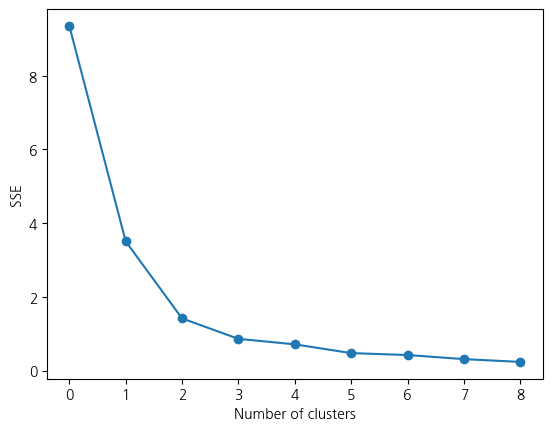

In [49]:
# 엘보우 기법
# 그래프볼 때 k 5개가 최적의 k값으로 보임
from sklearn.cluster import KMeans

sse=[]
for k in range(1,10):
    kmeans = KMeans(n_clusters=k, random_state=42, n_init='auto')
    kmeans.fit(weather_df_scale_pca)
    sse.append(kmeans.inertia_)

plt.rc('font', family='NanumGothic')
plt.plot(sse, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('SSE')
plt.show()

In [50]:
# 실루엣 점수
from sklearn.metrics import silhouette_score
for k in range(2,10):
    kmeans = KMeans(n_clusters=k, random_state=42, n_init='auto')
    kmeans.fit(weather_df_scale_pca)
    y_pred = kmeans.labels_
    print(k, ": ", silhouette_score(weather_df_scale_pca, y_pred, metric='euclidean'))

# 실루엣 점수로 볼 때 k가 3일 때 가장 점수가 높음

2 :  0.5840903332875007
3 :  0.6464410039802926
4 :  0.6768778998104733
5 :  0.6840536346083854
6 :  0.6985298552223467
7 :  0.6777869001632073
8 :  0.7146502823593673
9 :  0.7237643806620699


In [51]:
# 그룹 수, random_state 설정
k=3

model = KMeans(n_clusters = k, random_state = 42)

# 정규화된 데이터에 학습
model.fit(weather_df_scale_pca)

# 클러스터링 결과 각 데이터가 몇 번째 그룹에 속하는지 저장
weather_df_scale_pca['cluster'] = model.labels_

In [52]:
clusters = weather_df_scale_pca.groupby('cluster')
print(clusters.mean())
print(clusters.size())

              PC1       PC2
cluster                    
0       -0.365763 -0.144398
1        0.528818 -0.089677
2       -0.037800  0.157259
cluster
0    19
1    15
2    26
dtype: int64


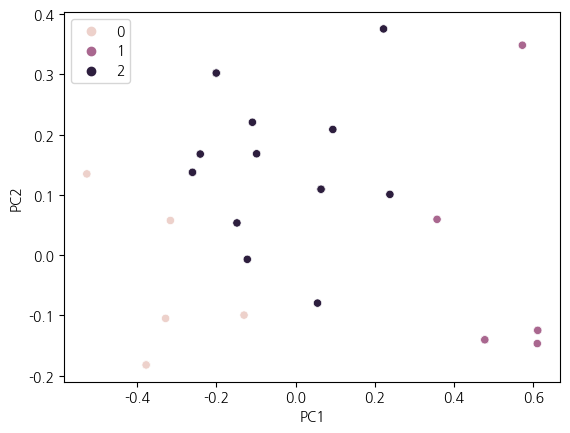

In [53]:
sns.scatterplot(x='PC1', y='PC2', data=weather_df_scale_pca, hue='cluster', legend="full")
plt.legend()
plt.show()

In [54]:
weather_df['cluster'] = model.fit_predict(weather_df_scale_pca)

# 건물번호에 맞게 지역 cluster를 원본 데이터에 부여하기

In [55]:
areas = {0: list(weather_df[weather_df['cluster'] == 0].index),
         1: list(weather_df[weather_df['cluster'] == 1].index),
         2: list(weather_df[weather_df['cluster'] == 2].index)}

In [56]:
train['area'] = train['건물번호'].apply(lambda x: next((key for key, value in areas.items() if x in value), None))
test['area'] = test['건물번호'].apply(lambda x: next((key for key, value in areas.items() if x in value), None))

In [57]:
weather_df = train.groupby(['건물번호']).agg(평균풍속=('풍속','mean'), 평균기온=('기온','mean'), 
                                         평균습도=('습도','mean'), 평균일조=('일조','mean'), 평균강수량=('강수량','mean'))
weather_df['cluster'] = model.labels_

weather_df.groupby('cluster').agg({'평균풍속':'mean', '평균기온':'mean', '평균습도':'mean', '평균일조':'mean', '평균강수량':'mean'})


# 클러스터 0은 평균적으로 낮은 풍속, 낮은 기온, 낮은 습도, 일조량, 강수량을 가지고 있으며, 
# 클러스터 1은 평균적으로 중간 수준의 풍속, 기온, 습도, 일조량, 강수량을 가지고 있습니다. 
# 클러스터 2는 평균적으로 높은 풍속, 낮은 기온, 높은 습도, 일조량, 강수량을 가지고 있습니다.

,평균풍속,평균기온,평균습도,평균일조,평균강수량
cluster,,,,,
0,2.134879,24.596597,75.758320,0.187322,0.486463
1,1.703443,24.409942,82.424508,0.215965,0.514346
2,2.949748,23.540598,81.849706,0.242520,0.552239


# feature 분석

## 날씨 열

### 기온

In [58]:
train.head(2)

,건물번호,시간,전력사용량,기온,풍속,습도,강수량,일조,비전기냉방설비운영,태양광보유,hour,weekday,date,day,month,건물유형,area
0,1,2020-06-01 00:00:00,8179.056,17.6,2.5,92.0,0.8,0.0,0.0,0.0,0,0,2020-06-01,1,6,1,0
1,1,2020-06-01 01:00:00,8135.640,17.7,2.9,91.0,0.3,0.0,0.0,0.0,1,0,2020-06-01,1,6,1,0


In [59]:
grouped_data  = train.groupby(['area', 'month']).agg({'기온' : ['mean'], '전력사용량' : ['mean']})
grouped_data

기온        전력사용량
                 mean         mean
area month                        
0    6      23.871089  2490.163851
     7      24.027292  2535.046197
     8      26.238834  2684.163940
1    6      23.281832  2224.635360
     7      23.486740  2289.198795
     8      27.012547  2433.127737
2    6      22.189241  1857.373609
     7      22.531900  2023.396459
     8      26.532697  2349.817867

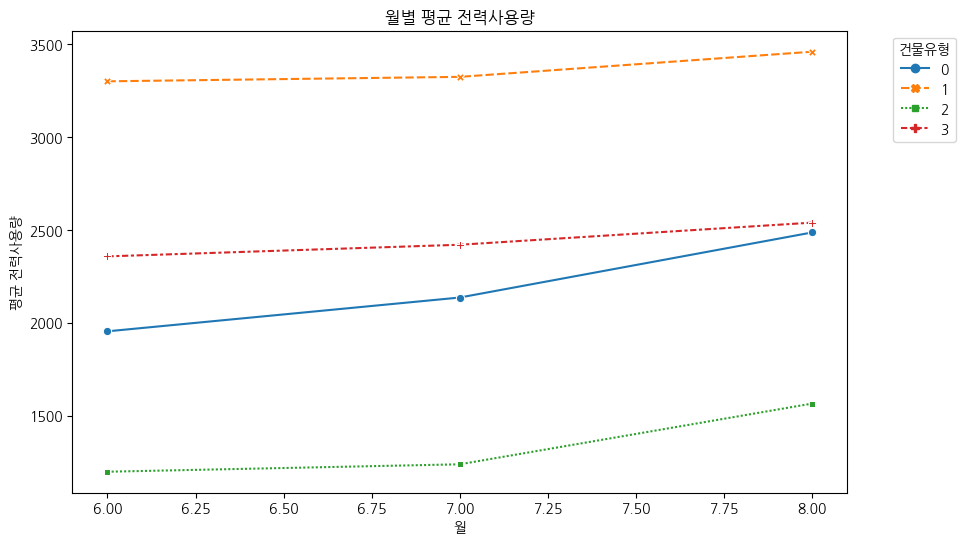

In [60]:
grouped_data  = train.groupby(['건물유형', 'month']).agg({'기온' : ['mean'], '전력사용량' : ['mean']}).reset_index()
pivot_data = grouped_data.pivot(index='month', columns='건물유형')

plt.figure(figsize=(10, 6))
sns.lineplot(data=pivot_data['전력사용량']['mean'], markers=True)
plt.title('월별 평균 전력사용량')
plt.xlabel('월')
plt.ylabel('평균 전력사용량')
handles, labels = plt.gca().get_legend_handles_labels()
plt.legend(handles, labels, title='건물유형', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

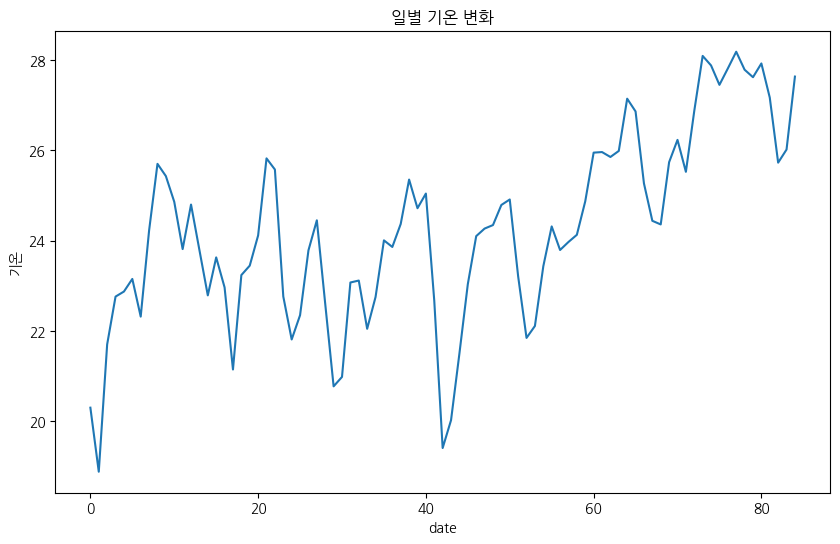

In [61]:
grouped_data = train.groupby(['date']).agg({'기온': ['mean'], '전력사용량': ['mean']}).reset_index()
humidity_data = grouped_data['기온']['mean']
power_data = grouped_data['전력사용량']['mean']

plt.figure(figsize=(10, 6))
sns.lineplot(data=humidity_data)
plt.title('일별 기온 변화')
plt.xlabel('date')
plt.ylabel('기온')
plt.show()

In [62]:
# 월별 기온은 증가하고 있고 이에 따라 냉방시설을 많이 사용하면서 전력사용량이 증가하고 있다.

### 풍속

In [63]:
# 기온 + 풍속 -> 체감온도
# 체감온도 = -0.2442 + 0.55399Tw + 0.45535Ta – 0.0022Tw2 + 0.00278TwTa + 3.0
# Ta : 기온(°C), Tw : 습구온도(Stull의 추정식** 이용), RH : 상대습도(%)
# Tw = Ta * ATAN[0.151977*(RH+8.313659)**(1/2)] + ATAN(Ta+RH) - ATAN(RH-1.67633) + 0.00391838*RH**(3/2)*ATAN(0.023101*RH) - 4.686035
# 체감온도가 높아지면 에어컨 사용량 증가
# 풍속이 높아지면 체감온도가 낮아져 에어컨 사용량 감소 -> 전력사용량 감소??
# 건물 내부에도 영향을 미칠까??

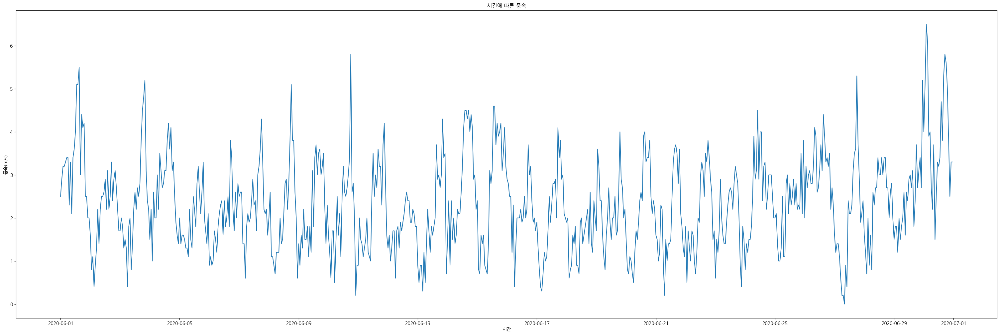

In [64]:
fig = plt.figure(figsize = (30, 10))
ax = fig.add_subplot()
ax = sns.lineplot(x=train[(train['건물번호'] == 1) & (train['month'] == 6)]['시간'],
                    y=train[(train['건물번호'] == 1) & (train['month'] == 6)]['풍속'].values)
# ax.set_ylim(2000, 8000)
# ax.set_xlim(0, 24)
# ax.set_title(f'6월 {i}일 전력사용량')

# plt.grid(False)
# plt.title('날짜에 따른 전력사용량')
# plt.xlabel('날짜')
# plt.ylabel('전력사용량(kWh)', rotation = True, labelpad = 20)
fig.tight_layout()
plt.title('시간에 따른 풍속')
plt.ylabel('풍속(m/s)')
plt.show()

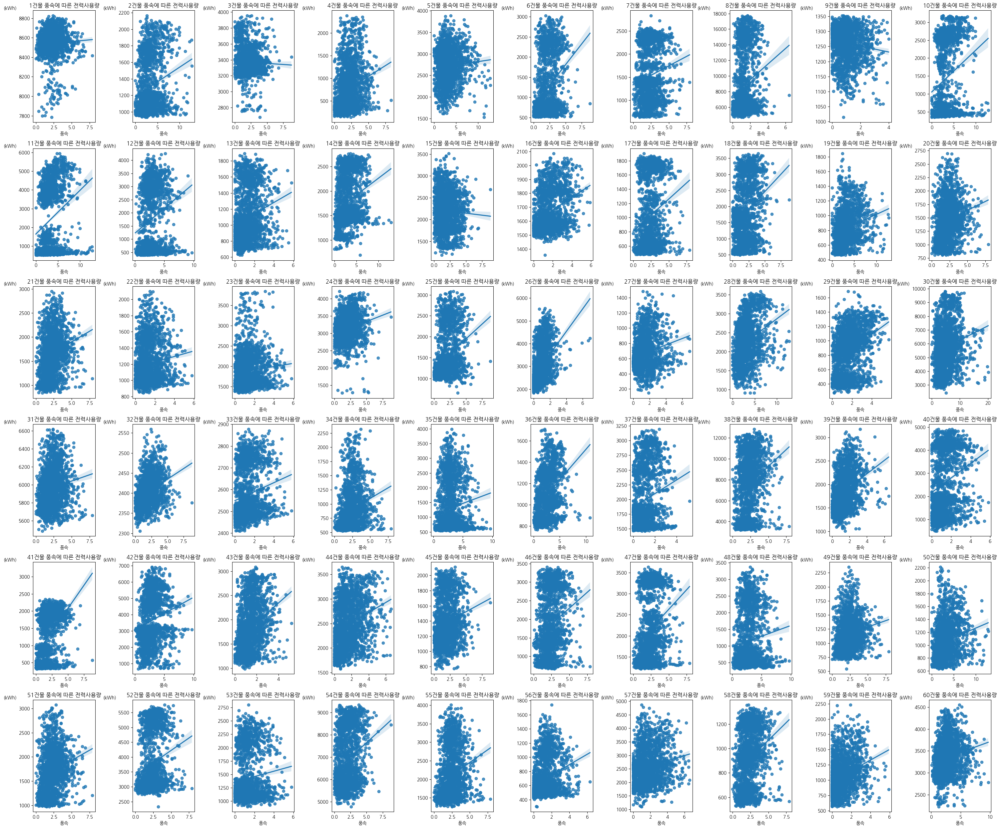

In [65]:
fig = plt.figure(figsize = (30, 25))

for i in range(1, 61):
    ax = fig.add_subplot(6, 10, i) 
    ax = sns.regplot(x=train[(train['건물번호'] == i)]['풍속'],
                    y=train[(train['건물번호'] == i)]['전력사용량'].values)
    # ax.set_ylim(6900, 8900)
    # ax.set_xlim(0, 24)
    ax.set_ylabel('(kWh)', loc = 'top', rotation = True)
    ax.set_title(f'{i}건물 풍속에 따른 전력사용량')

# plt.grid(False)
# plt.title('날짜에 따른 전력사용량')
# plt.xlabel('날짜')
# plt.ylabel('전력사용량(kWh)', rotation = True, labelpad = 20)
fig.tight_layout()
plt.show()

In [ ]:
fig = plt.figure(figsize = (30, 25))

for i in range(1, 61):
    ax = fig.add_subplot(6, 10, i) 
    ax = sns.lineplot(x=train[(train['건물번호'] == i)]['풍속'],
                    y=train[(train['건물번호'] == i)]['기온'])
    # ax.set_ylim(6900, 8900)
    # ax.set_xlim(0, 24)
    ax.set_title(f'{i}건물 풍속에 따른 전력사용량')

# plt.grid(False)
# plt.title('날짜에 따른 전력사용량')
# plt.xlabel('날짜')
# plt.ylabel('전력사용량(kWh)', rotation = True, labelpad = 20)
fig.tight_layout()
plt.show()

### 습도

In [ ]:
grouped_data = train.groupby(['date']).agg({'습도': ['mean'], '전력사용량': ['mean']}).reset_index()
humidity_data = grouped_data['습도']['mean']
power_data = grouped_data['전력사용량']['mean']

plt.figure(figsize=(10, 6))
sns.lineplot(data=humidity_data)
plt.title('일별 습도 변화')
plt.xlabel('date')
plt.ylabel('습도')
plt.show()

In [ ]:
plt.figure(figsize=(10, 6))
sns.lineplot(data=power_data)
plt.title('일별 전력사용량 변화')
plt.xlabel('date')
plt.ylabel('전력사용량')
plt.show()

In [ ]:
# 기온이 증가할수록 전력사용량을 증가함
# 시간이 지날수록 습도가 높아짐 -> 기온이 높아짐 -> 전력사용량이 높아짐 
# 따라서, 습도가 전력사용량에 어느정도 영향이 있음을 확인

### 강수량

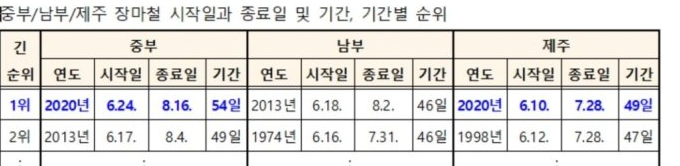

In [ ]:
grouped_data  = train.groupby(['area', 'month']).agg({'기온' : ['mean'], '풍속' : ['mean'], '습도' : ['mean'], '강수량' : ['mean'], '일조' : ['mean']})
grouped_data

In [ ]:
sns.scatterplot(data=train[train['건물번호']==2], x='강수량', y='전력사용량')
plt.title('2번 건물의 강수량에 따른 전력사용량')
plt.show()

In [ ]:
grouped_data

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(15, 10))

# 기온 그래프
sns.lineplot(x='month', y=('기온', 'mean'), hue='area', data=grouped_data, ax=axes[0, 0])
axes[0, 0].set_title('Mean Temperature by Month')
axes[0, 0].set_xlabel('Month')
axes[0, 0].set_ylabel('Mean Temperature')

# 풍속 그래프
sns.lineplot(x='month', y=('풍속', 'mean'), hue='area', data=grouped_data, ax=axes[0, 1])
axes[0, 1].set_title('Mean Wind Speed by Month')
axes[0, 1].set_xlabel('Month')
axes[0, 1].set_ylabel('Mean Wind Speed')

# 습도 그래프
sns.lineplot(x='month', y=('습도', 'mean'), hue='area', data=grouped_data, ax=axes[1, 0])
axes[1, 0].set_title('Mean Humidity by Month')
axes[1, 0].set_xlabel('Month')
axes[1, 0].set_ylabel('Mean Humidity')

# 강수량 그래프
sns.lineplot(x='month', y=('강수량', 'mean'), hue='area', data=grouped_data, ax=axes[1, 1])
axes[1, 1].set_title('Mean Rainfall by Month')
axes[1, 1].set_xlabel('Month')
axes[1, 1].set_ylabel('Mean Rainfall')

# 서브플롯 간 간격 조정
plt.tight_layout()

# 그래프 보여주기
plt.show()

In [ ]:
fig = plt.figure(figsize=(15,5))
a1 = train[train['건물번호']==1]
a1 = a1.groupby('date').agg({'강수량':'sum'})

sns.barplot(data=a1, x=a1.index, y='강수량')
plt.xticks(rotation=90)
plt.title('지역 0의 강수량')
plt.show()

In [ ]:
fig = plt.figure(figsize=(15,5))
a1 = train[train['건물번호']==2]
a1 = a1.groupby('date').agg({'강수량':'sum'})

sns.barplot(data=a1, x=a1.index, y='강수량')
plt.xticks(rotation=90)
plt.title('지역 2의 강수량')
plt.show()

In [ ]:
fig = plt.figure(figsize=(15,5))
a1 = train[train['건물번호']==3]
a1 = a1.groupby('date').agg({'강수량':'sum'})

sns.barplot(data=a1, x=a1.index, y='강수량')
plt.xticks(rotation=90)
plt.title('지역 1의 강수량')
plt.show()

In [ ]:
# 강수량에 따라 전력 사용량이 많은지 확인하기

### 일조
- 일조 : 태양 광선이 구름이나 안개로 가려지지 않고 땅 위를 비치는 것
- 일조시간 : 실제로 빛이 비친 시간. 보통 1일이나 한달 동안 비친 총 시간 수로 표시함.

In [ ]:
corr = []
for num in range(1,61):
    df = train[train.건물번호==num]
    num_corr = df.corr()['일조']
    num_corr = num_corr.drop(['건물번호','비전기냉방설비운영','태양광보유','일조'])
    corr.append(num_corr)
corr_df = pd.concat(corr, axis=1).T
corr_df.index = list(range(1,61))

# 시각화
f, ax = plt.subplots(figsize=(20,8))
plt.title("건물별 일조량과 변수들의 상관관계", fontsize=15)
sns.heatmap(corr_df.T, cmap=sns.diverging_palette(240,10,as_cmap=True), ax=ax)
plt.xlabel('건물(num)')
plt.show()

In [ ]:
# lag a row by group 'id'

train['일조_1'] =  train.sort_values(by='시간', ascending=True).groupby('건물번호')['일조'].shift(1)
train['일조_2'] =  train.sort_values(by='시간', ascending=True).groupby('건물번호')['일조_1'].shift(1)
train.head()

In [ ]:
# 스타일 적용 함수 정의
def highlight_max_abs(row):
    abs_vals = row.abs()
    return ['background-color: yellow' if val == abs_vals.max() else '' for val in row]

results = []

for num in range(1, 61):
    df = train[train.건물번호 == num]
    df_sun = df[df.태양광보유 == 1]
    num_corr = df_sun.corr()['전력사용량']
    result = {
        '건물번호': num,
        '일조': round(num_corr['일조'], 3),
        '일조_1': round(num_corr['일조_1'], 3),
        '일조_2': round(num_corr['일조_2'], 3)
    }
    results.append(result)

df_results = pd.DataFrame(results)
df_results = df_results.dropna()
df_results = df_results.set_index(keys='건물번호')
df_results

# 스타일 적용
styled_df = df_results.style.apply(highlight_max_abs, axis=1)

# 스타일이 적용된 데이터프레임 출력
styled_df

In [ ]:
# 기온이 높을수록 전력사용량이 늘어난 것을 확인했지만 일조가 높을수록 전력사용량이 높을까?
# 결론 : 건물마다 다르다.
# 건물의 에너지 효율성 차이라고 생각합.
# 따라서, 일조는 전력사용량에 영향을 주는 변수가 아님

a1 = train[train['건물번호']==3]
a1 = a1.groupby('일조').agg({"전력사용량":'mean'})
sns.barplot(data=a1, x=a1.index, y='전력사용량')
plt.title('3번 건물의 일조별 전력사용량')
plt.show()

# 3번 건물의 건물유형은 3
# 3번 건물의 지역은 1

In [ ]:
a1 = train[train['건물번호']==6]
a1 = a1.groupby('일조').agg({"전력사용량":'mean'})
sns.barplot(data=a1, x=a1.index, y='전력사용량')
plt.title('6번 건물의 일조별 전력사용량')
plt.show()

# 3번 건물의 건물유형은 3
# 3번 건물의 지역은 1

### 비전기냉방설비

In [ ]:
# 군집
c_1 = [4, 10, 11, 12, 28, 29, 30, 36, 40, 41, 42, 59, 60]
c_2 = [1, 5, 9, 34]
c_3 = [19, 20, 21, 49, 50, 51]
c_4 = [2, 3, 6, 7, 8, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 31, 32, 33, 35, 37, 38, 39, 43, 44, 45, 46, 47, 48, 52, 53, 54, 55, 56, 57, 58]

In [ ]:
intersection_1_0 = sorted(list(set(train[train['비전기냉방설비']==0]['건물번호'].unique()).intersection(c_1)))
intersection_1_1 = sorted(list(set(train[train['비전기냉방설비']==1]['건물번호'].unique()).intersection(c_1)))
intersection_2_0 = sorted(list(set(train[train['비전기냉방설비']==0]['건물번호'].unique()).intersection(c_2)))
intersection_2_1 = sorted(list(set(train[train['비전기냉방설비']==1]['건물번호'].unique()).intersection(c_2)))
intersection_3_0 = sorted(list(set(train[train['비전기냉방설비']==0]['건물번호'].unique()).intersection(c_3)))
intersection_3_1 = sorted(list(set(train[train['비전기냉방설비']==1]['건물번호'].unique()).intersection(c_3)))
intersection_4_0 = sorted(list(set(train[train['비전기냉방설비']==0]['건물번호'].unique()).intersection(c_4)))
intersection_4_1 = sorted(list(set(train[train['비전기냉방설비']==1]['건물번호'].unique()).intersection(c_4)))

In [ ]:
# 군집별 비전기 냉방 설비 유무에 따른 전력사용량
fig, ax = plt.subplots()

ax = sns.lineplot(data = train[train['건물번호'].isin(c_1)], x = '건물번호', y = '전력사용량', hue = '비전기냉방설비')
plt.title('1군집의 건물별 비전기 냉방 설비 유무에 따른 전력사용량')

In [ ]:
fig, ax = plt.subplots()

ax = sns.lineplot(data = train[train['건물번호'].isin(c_2)], x = '건물번호', y = '전력사용량', hue = '비전기냉방설비')
plt.title('2군집의 건물별 비전기 냉방 설비 유무에 따른 전력사용량')

In [ ]:
fig, ax = plt.subplots()

ax = sns.lineplot(data = train[train['건물번호'].isin(c_3)], x = '건물번호', y = '전력사용량', hue = '비전기냉방설비')
plt.title('3군집의 건물별 비전기 냉방 설비 유무에 따른 전력사용량')

In [ ]:
fig, ax = plt.subplots()

ax = sns.lineplot(data = train[train['건물번호'].isin(c_4)], x = '건물번호', y = '전력사용량', hue = '비전기냉방설비')
plt.title('4군집의 건물별 비전기 냉방 설비 유무에 따른 전력사용량')

In [ ]:
fig, ax = plt.subplots()

ax = sns.lineplot(data = train, x = '건물번호', y = '전력사용량', hue = '비전기냉방설비')
plt.title('비전기 냉방 설비 유무에 따른 건물별 전력사용량')

In [ ]:
train['비전기'] = train['비전기냉방설비'].apply(lambda x : '유' if x == 1 else '무')

In [ ]:
fig, ax = plt.subplots()

ax = sns.boxplot(data = train, x = '비전기', y = '전력사용량')
plt.title('비전기 냉방 설비 유무에 따른 전력사용량 분포')
plt.xlabel('비전기 냉방 설비')
plt.ylabel('전력사용량(kWh)')

# 기본적으로 전력사용량이 높은 곳에서 비전기냉방설비를 사용

### 태양광 보유

In [ ]:
# 박스 플롯 그리기
plt.figure(figsize=(5, 5))
sns.boxplot(train, x='태양광보유', y='전력사용량', hue='태양광보유')
plt.xlabel('태양광 보유')
plt.ylabel('전력사용량')
plt.title('태양광 보유 유무에 따른 전력사용량 분포')
plt.show()

## hour 
- hour는 0~23이기 때문에 비슷한 시간이여도 멀게 느껴지기 때문에 sin, cosine 함수를 활용해 변환하여 순환적인 성격을 반영한다.
- https://dacon.io/competitions/official/235680/codeshare/2366?page=1&dtype=recent

In [ ]:
train['sin_time'] = np.sin(2*np.pi*train.hour/24)
train['cos_time'] = np.cos(2*np.pi*train.hour/24)

In [ ]:
grouped_data = train.groupby(['건물유형','hour']).agg({'전력사용량':'mean'}).reset_index()
grouped_data

In [ ]:
sns.lineplot(data=grouped_data, x='hour', y='전력사용량', hue='건물유형')
plt.legend(loc='upper right')
plt.show()

## weekday
- 0 ~ 6 (5, 6은 주말, 나머지는 평일)
- 공휴일에는 어떨까?
- 공휴일은 정해진 데이터에서는 8월 15일(토) 뿐 -> 건물유형마다 다름
- 따라서, holiday라는 변수 추가 (0: 평일, 1: 공휴일(토, 일, 공휴일))

In [ ]:
building_numbers = list(range(1, 61))
filtered_data = train[train['건물번호'].isin(building_numbers)]

# 건물별 평균 전력 사용량 계산
average_power_usage = filtered_data.groupby(['건물번호', 'weekday'])['전력사용량'].mean().reset_index()

# 서브플롯으로 그래프 그리기
fig, axes = plt.subplots(10, 6, figsize=(18,30))
for i, ax in enumerate(axes.flatten()):
    building_number = i + 1
    building_data = average_power_usage[average_power_usage['건물번호'] == building_number]
    sns.lineplot(data=building_data, x='weekday', y='전력사용량', ax=ax, linewidth=2)
    ax.set_xlabel('weekday')
    ax.set_ylabel('평균 전력사용량')
    ax.set_title(f'건물 {building_number}의 평균 전력사용량')
    ax.set_xticks(range(0, 7, 1))
    
plt.tight_layout()
plt.show()

In [ ]:
train.columns

In [ ]:
test.columns

In [ ]:
# 공휴일 변수 추가
train['holiday'] = train.apply(lambda x : 0 if x['weekday']<5 else 1, axis = 1)
test['holiday'] = test.apply(lambda x : 0 if x['weekday']<5 else 1, axis = 1)

In [ ]:
# 실제 달력보면 2020-08-17이 임시공휴일임 -> holiday를 1로 바꿈
train['date'] = pd.to_datetime(train['date'])
train.loc[('2020-08-17'<=train.date)&(train.date<'2020-08-18'), 'holiday'] = 1

In [ ]:
# 확인
a57 = train[train['건물번호']==57]

In [ ]:
b1 = a57[(a57['date'] == '2020-08-16') | (a57['date'] == '2020-08-17') | (a57['date'] == '2020-08-18')]

fig = plt.figure(figsize=(15,6))
sns.lineplot(data=b1, x='hour', y='전력사용량', hue='day',  palette=['red', 'green', 'blue'])
plt.title('57번 건물의 16, ,17, 18일 전력사용량')
plt.show()

# 57번 건물 평일보다 공휴일에 더 많이 사용함(17일 임시공휴일 포함)

In [ ]:
a42 = train[train['건물번호']==42]
b2 = a42[(a42['date'] == '2020-08-16') | (a42['date'] == '2020-08-17') | (a42['date'] == '2020-08-18')]

fig = plt.figure(figsize=(15,6))
sns.lineplot(data=b2, x='hour', y='전력사용량', hue='day',  palette=['red', 'green', 'blue'])
plt.title('42번 건물의 16, ,17, 18일 전력사용량')
plt.show()

# 42번 건물은 주말에 더 많이 사용하는 것을 알 수 있음

# feature engineering

## CDH(냉방도일)

In [ ]:
# 냉방도일 파생변수 추가
# 냉방도일 : 일평균 기온 24℃ 이상의 값에 대한 1년간의 적산 온도를, 도일수(degree day)를 단위로 하여 나타낸 것
# 도일(degree day): 외부 기온과 실내 기온의 차와 이에 따라 소요되는 연료 소비를 고려한 기후 수치
# 냉방기준 온도가 26도이기 때문에 -> 에너지 절약, 건강 차원
# 도일의 특징
# - 1. 도일이 크면 연료의 소비량은 많아지고, 작을수록 연료의 소비량은 적어진다.
# - 2. 도일은 그 지방의 연료 소비량을 추정할 수 있지만 설비용량은 정확하게 산출 불가다.
# - 3. 도일은 실내온도가 같아도 외기온도가 다르기 때문에 지역마다 그 값은 다르게 나타난다.


def CDH(xs):
    ys = []
    for i in range(len(xs)):
        if i < 11:
            ys.append(np.sum(xs[:(i+1)]-26))
        else:
            ys.append(np.sum(xs[(i-11):(i+1)]-26))
    return np.array(ys)

cdhs = np.array([])
for num in range(1,61,1):
    temp = train[train['건물번호'] == num]
    cdh = CDH(temp['기온'].values)
    cdhs = np.concatenate([cdhs, cdh])
train['CDH'] = cdhs

cdhs = np.array([])
for num in range(1,61,1):
    temp = test[test['건물번호'] == num]
    cdh = CDH(temp['기온'].values)
    cdhs = np.concatenate([cdhs, cdh])
test['CDH'] = cdhs

In [ ]:
for c in range(4):
    temp_1 = train[train.건물유형 == c]
    nums = np.unique(temp_1['건물번호'])
    n_nums = len(nums)
    fig = plt.figure(figsize = (16, 3*(n_nums//5+1)+1))
    plt.suptitle(f'cluster{c}')
    for i, num in enumerate(nums):
        temp_2 = temp_1[temp_1['건물번호'] == num]
        temp_2_tg = temp_2.groupby(['건물유형','date','holiday'])[['전력사용량']].sum().reset_index()
        temp_2_cdh = temp_2.groupby(['건물유형','date','holiday'])[['CDH']].sum().reset_index()
        temp_2 = temp_2_tg.merge(temp_2_cdh, on = ['건물유형','date','holiday'], how= 'left')
        plt.subplot(n_nums//5+1,5, i+1)
        sns.scatterplot(data = temp_2, x='CDH', y='전력사용량', hue= 'holiday')
        plt.title(f'building {num}')
        plt.ylabel('전력사용량')
        plt.xlabel('냉방도일')
        plt.subplots_adjust(wspace = 0.5, hspace = 0.5)


# 지역에 따른 건물별 CDH 관계를 봤을 때, 지역과는 상관이 없음 -> 건물 유형과 관련 있을 듯
# 건물유형별 CDH 관계를 봤을 때, 건물유형에 따른 냉방도일 양상이 비슷함 -> 따라서, 냉방도일은 전력사용량에 영향을 미치는 변수임

## 체감온도

In [ ]:
def Perceived_Temp(df):
    df['습구온도'] = df['기온'] * np.arctan(0.151977*((df['습도']+8.313659)**(1/2))) + np.arctan(df['기온']+df['습도']) - np.arctan(df['습도']-1.67633) + 0.00391838*(df['습도']**(3/2))*np.arctan(0.023101*df['습도']) - 4.686035
    df['체감온도'] = -0.2442 + 0.55399 * df['습구온도'] + 0.45535 * df['기온'] - 0.0022 * (df['습구온도'] ** 2) + 0.00278 * df['습구온도'] * df['기온'] + 3.0

Perceived_Temp(train)
Perceived_Temp(test)

## 불쾌지수

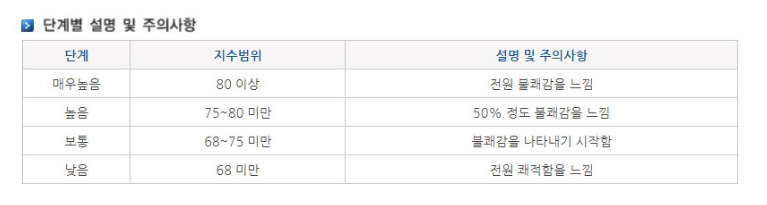

In [ ]:
def THI_func(df):
    df['불쾌지수'] = 1.8 * df['기온'] - 0.55*(1-df['습도'])*(1.8*df['기온']-26)+32
THI_func(train)
THI_func(test)

In [ ]:
sns.scatterplot(data=train[train['건물번호']==53], x='불쾌지수', y='전력사용량')

In [ ]:
thi_df = train[train['불쾌지수']<80]
thi_df
# 80 미만인 데이터가 187개임

In [ ]:
thi_df['hour'].value_counts()

In [ ]:
plt.figure(figsize=(10, 6))
sns.countplot(data=thi_df, x='hour')
plt.title('시간대별 불쾌지수가 80이하 개수')
plt.xlabel('시간대')
plt.ylabel('개수')
plt.show()

# 낮 시간대는 불쾌감을 잘 느낌
# 밤, 잘 시간에는 불쾌감을 덜 느낌

In [ ]:
weather_df = train.groupby(['건물번호']).agg(평균풍속=('풍속','mean'), 평균기온=('기온','mean'), 
                                         평균습도=('습도','mean'), 평균일조=('일조','mean'), 평균강수량=('강수량','mean'))
weather_df['cluster'] = model.labels_

In [ ]:
weather_df.groupby('cluster').agg({'평균풍속':'mean', '평균기온':'mean', '평균습도':'mean', '평균일조':'mean', '평균강수량':'mean'})

# 클러스터 0은 평균적으로 낮은 풍속, 낮은 기온, 낮은 습도, 일조량, 강수량을 가지고 있으며, 
# 클러스터 1은 평균적으로 중간 수준의 풍속, 기온, 습도, 일조량, 강수량을 가지고 있습니다. 
# 클러스터 2는 평균적으로 높은 풍속, 낮은 기온, 높은 습도, 일조량, 강수량을 가지고 있습니다.

# 1번 지역이 전체적으로 기온과 습도가 높음 -> 불쾌지수

In [ ]:
# 0, 1, 2 지역의 특징 나타내기